In [1]:
import numpy as np
import matplotlib.pyplot as plt
import json
import IPython.display as ipd
from scipy.signal import find_peaks, peak_prominences

from helper import *

plt.rcParams['figure.figsize'] = 10, 5

## Music for DOA Implementation for real data

In this notebook, we will test our different versions of the MUSIC algorithm on real data coming from the **Pyramic dataset**: https://github.com/fakufaku/pyramic-dataset

The recordings we used were performed by a Pyramic (https://github.com/LCAV/Pyramic) 48-microphone array in an anechoic chamber. The dataset contains several types of recording, e.g **sweeps and speech recordings** - recording types on which we will focus here.

The notebook is divided in 6 parts:
- **Microphone locations** - we retrieve several information about the microphone array
- **Global parameters and algorithm definitions** - we define some useful variables and our versions of the MUSIC algorithm
- **Single source** - we explain each phase of the research/implementation process until the final implementation version, and we compare the basic and improved algorithms
- **Two correlated sources** - we compare our versions of the algorithm on sweep and speech recordings composed of two correlated sources
- **Two uncorrelated sources** - we compare our versions of the algorithm on sweep and speech recordings composed of two uncorrelated sources
- **Conclusion** - we conclude on our work overall

For the rest of the notebook, [n] corresponds to the n-th reference (listed at the end).

For some signals (shortnames _speechco, speechun, sweepco, sweepun_), the actual angles of arrival were computed using the MUSIC implementation of the Pyroomacoustic library. This allowed us to compare our results with theirs, which are supposed to be pretty accurate.

### Microphone locations

As mentionned before, the microphone array is the Pyramic device, which has a 3D shape and is composed of microphones at different heights.

We are only interested in the microphones located on the same 2D plane as the top speaker (speaker 0), therefore we retrieve the indices of those.

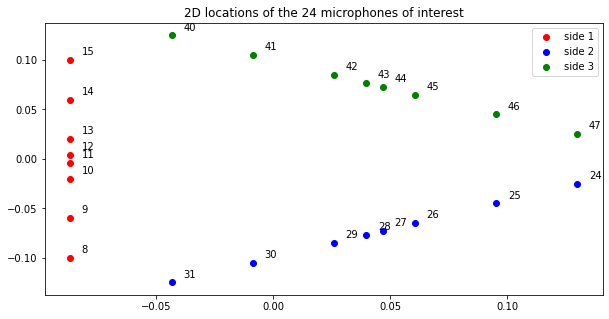

Total 48 microphones,
With 24 microphones on the 2D plane of interest,
at indices : [ 8  9 10 11 12 13 14 15 24 25 26 27 28 29 30 31 40 41 42 43 44 45 46 47]


In [2]:
with open('../data/protocol.json') as json_file:  
    protocol = json.load(json_file)
    
# Load the microphone locations from the pyramic protocol
microphone_3D_locations = np.array(protocol['geometry']['microphones']['locations'])
total_n_mics = len(microphone_3D_locations)

# Retrieve the indices of the microphones located in the same 2D plane as the speaker
is_top_mics = np.isclose(microphone_3D_locations[:, 2], 0.06123724)
n_top_mics = np.sum(is_top_mics)
top_mic_indices = np.arange(total_n_mics)[is_top_mics]

# Separate the indices into three categories, one for each side of the triangle-array
microphone_2D_locations = microphone_3D_locations[is_top_mics, :2]
side1_mic_indices = top_mic_indices[:8]
side2_mic_indices = top_mic_indices[8:16]
side3_mic_indices = top_mic_indices[16:24]

fig, ax = plt.subplots()
ax.scatter(microphone_3D_locations[side1_mic_indices, 0], microphone_3D_locations[side1_mic_indices, 1], color='red', label="side 1")
ax.scatter(microphone_3D_locations[side2_mic_indices, 0], microphone_3D_locations[side2_mic_indices, 1], color='blue', label="side 2")
ax.scatter(microphone_3D_locations[side3_mic_indices, 0], microphone_3D_locations[side3_mic_indices, 1], color='green', label="side 3")
ax.legend()
for i, txt in enumerate(top_mic_indices):
    plt.annotate(txt, (microphone_2D_locations[:, 0][i]+0.005, 
                       microphone_2D_locations[:, 1][i]+0.005))
plt.title(f"2D locations of the {n_top_mics} microphones of interest")
plt.show()

print(f"Total {total_n_mics} microphones,")
print(f"With {n_top_mics} microphones on the 2D plane of interest,")
print(f"at indices : {top_mic_indices}")

### Global parameters and algorithm definitions

In [3]:
# In order to simply load the downloaded files, we assign a shortname to each sample
filenames = {
    's3_sp0_20': 'fq_sample3_spkr0_angle20.wav',
    's3_sp0_30': 'fq_sample3_spkr0_angle30.wav',
    's3_sp0_70': 'fq_sample3_spkr0_angle70.wav',
    's1_sp0_20': 'fq_sample1_spkr0_angle20.wav',
    's1_sp0_30': 'fq_sample1_spkr0_angle30.wav',
    's1_sp0_70': 'fq_sample1_spkr0_angle70.wav',
    'swexp_sp0_20': 'sweep_exp_spkr0_angle20.wav',
    'sweepco': 'sweep_correlated.wav',
    'speechco': 'speech_correlated.wav',
    'sweepun': 'sweep_uncorrelated.wav',
    'speechun': 'speech_uncorrelated.wav'
}

# We can chose one side of the triangle array by changing the following variable
CHOSEN_SIDE = 1 # Can take value 1, 2, 3, "all"
side_mic_indices = top_mic_indices[(CHOSEN_SIDE-1)*8:CHOSEN_SIDE*8]

# Automatically compute the distance of each mic from the position of the first mic (used as a reference) of the selected array
d = mic_distances(microphone_3D_locations[side_mic_indices, :2])

# Define the range of angle search
# Since we focused on the first side of the triangle array and because the speaker can only be on front of it, 
# the range goes from -90 to 90 degrees
peak_search_range = np.arange(-90, 90, 1)

Hereafter is our implementation of the basic MUSIC algorithm, as described in [1]

In [4]:
def basic_music(X, f, d, D, M):
    """
    - X : the (M x D) matrix composed of the D received signals by each of the M microphones
    - f : the frequency of interest
    - d : the distance array between the microphones
    - D : the number of input sources
    - M : the number of microphones
    """
    
    # Make sure we have more microphones than input signals
    assert (M > D)

    # Peak search range (start degree, end degree, step)
    peak_search_range = np.arange(-90, 90, 1)
    peak_search_range_len = len(peak_search_range)

    # Compute the wavelength for X, wrt the input frequency
    wavelen = SPEED_OF_SOUND / f

    # Centralize X
    X_mean = np.mean(X, axis=1)
    X_centered = X - np.tile(X_mean, (np.shape(X)[1], 1)).T

    # Compute the covariance matrix estimation of the received signals
    R = np.dot(X_centered, X_centered.conj().T)

    # Eigen value decomposition of the cov. matrix
    eig_val, eig_vect = np.linalg.eig(R)

    # Pick the smallest M-D eigen values and their eigen vectors to represent the noise subspace. 
    # En can be therefore seen as the "noise matrix"
    # (the remaining eigen vectors represent the signal subspace)
    ids = np.abs(eig_val).argsort()[:(M - D)]
    En = eig_vect[:, ids]

    # Compute the covariance matrix estimation of the noise matrix: Ren = EnEn'
    Ren = np.dot(En, En.conj().T)

    # Compute the steering vector for each possible direction
    a_theta = np.exp(-1j * 2 * np.pi / wavelen * np.kron(d, np.sin(peak_search_range / peak_search_range_len * np.pi))
                     .reshape(M, peak_search_range_len))

    # Compute the resulting vector P
    P_MUSIC = np.zeros(peak_search_range_len)
    for j in range(peak_search_range_len):
        P_MUSIC[j] = 1 / abs(np.dot(np.dot(a_theta[:, j].conj().T, Ren), a_theta[:, j]))

    P_MUSIC = np.log(P_MUSIC / np.max(P_MUSIC))
    return P_MUSIC, peak_search_range

Followed by the improved version, based on references [1] and [2].
(More details about this version in the generated data notebook)

In [5]:
def improved_musicDOA(X, f, d, D, M, L=0, corr=False, resscale="log" ):
    K=M-L
    
    # Peak search range (start degree, end degree, step)
    peak_search_range = np.arange(-90, 90, 1)
    peak_search_range_size = len(peak_search_range)

    # Compute the wavelength for X
    wavelen = 343 / f

    # Centralize X
    X_mean = np.mean(X, axis=1)
    X_centered = X - np.tile(X_mean, (np.shape(X)[1], 1)).T

    # Compute the covariance matrix
    R = np.dot(X_centered, X_centered.conj().T)
    
    # Improvement in case of correlation
    if corr:
        J = np.flip(np.eye(M), axis=1)
        R = R + np.dot(J, np.dot(R.conj(), J))

    # Eigen values decomposition of R
    eig_val, eig_vect = np.linalg.eig(R)
    
    # Find the smallest eigenvalues
    ids = np.abs(eig_val).argsort()[:(L+1)]  
    En = eig_vect[:,ids]
    
    # Noise subspace estimation: Ren = EnEn'
    Ren = np.dot(En, En.conj().T)
   
    # Size = future size of Pmusic
    Size = np.size(peak_search_range)

    m=np.arange(M)
    a=np.zeros((M,L+1))*1j
    Pmusic = np.zeros(Size)
    
    atheta = np.exp(-1j * 2 * np.pi / wavelen *
                    np.kron(d, np.sin(peak_search_range / 180 *np.pi)).reshape(M,peak_search_range_size))
    
    for j in range(peak_search_range_size):
        a[:K, 0] = atheta[:K,j]
        a[K:, 1:] = np.diag(atheta[K:,j])
        #Pmusic[j] = 1 / abs(np.dot(np.dot(atheta[:, j].conj().T, Ren), atheta[:, j]))
        Pmusic[j] = 1/abs(np.linalg.det(np.dot(a.conj().T, np.dot(Ren, a))))
        
    
    # Spatial spectrum function
    if resscale == "log":
        Pmusic = 10 * np.log10(Pmusic / np.max(Pmusic))    
    
    return Pmusic, peak_search_range

### Single-source 

First focused on a single source experiment in order to test our different versions of the MUSIC algorithm.
We loaded an audio recording from the Pyramic dataset: sweep_exp_spkr0_angle20.wav (exponential sweep with direction of arival 20 degrees).

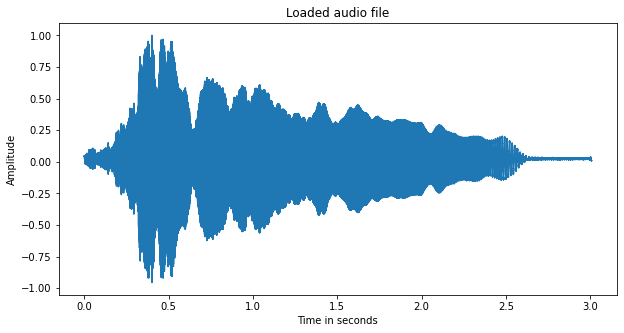

In [6]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("swexp_sp0_20", filenames, retrieve_angle=True)
# Add a play button
ipd.Audio(chosen_file_path)

#### First technique

Since the MUSIC algorithm relies on the covariance matrix of the received signals, which itself needs the signals to be wide-sense-stationary (WSS), we first decided to focus on a single time-frame analysis, with frame size 1000 samples. This way, the part we focus on would be closer to a WSS signal, and the MUSIC algorithm would, in theory and assuming the list of assumptions described in the generated data algorithm, be applicable. 

We started by choosing the time-frame at a glance (the "most energetic" looking part of the signal), i.e around 0.8s, corresponding to the sample range [13000, 14000]:

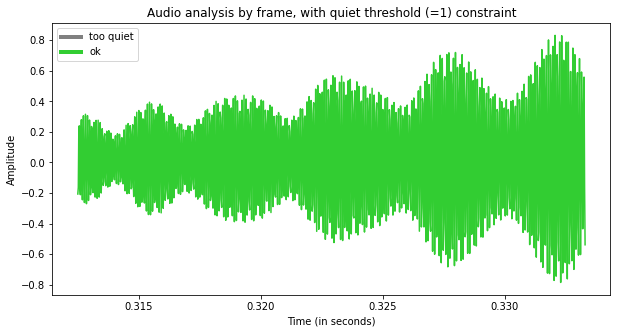

1 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [7]:
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices,
                                                  audio_time_range=np.arange(15000, 16000),
                                                  plot=True, freq_range=None)

As we can see, the selected segment of the signal is closer to a periodic signal, and therefore to a WSS one.

Then, by computing the Power Spectral Density we retrieved the highest energy frequency of this frame, i.e 736 Hz.

In [8]:
print(freqs_by_time_range)

{'15000, 15999': array([11088.])}


We had now everything to run the MUSIC algorithm.

In [9]:
freqs = list(freqs_by_time_range.values())
P_MUSIC, _ = basic_music(X_array[0], f=freqs[0][0], d=d, D=2, M=len(side_mic_indices))

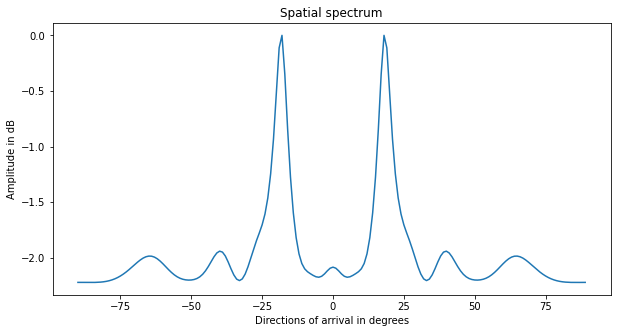

In [10]:
plt.plot(peak_search_range, P_MUSIC)
plt.title('Spatial spectrum')
plt.xlabel('Directions of arrival in degrees')
plt.ylabel('Amplitude in dB')
plt.show()

In [11]:
find_angles(P_MUSIC, peak_search_range, [20], prominence=0.5)

Actual angle(s) is/are: [20]
Angle(s) found is/are: [-18  18]
0 / 2 correct guesses


array([-18,  18])

The above graph corresponds to the output of the MUSIC algorithm, i.e the resulting spatial spectrum. We can observe that the peak is located around 18 degrees instead of 20, not bad!

#### Second technique

After focusing on only one time-frame, we wondered what it would give if we ran through every time-frame of the signal, and kept the best at the end, or some other elimination/average technique.

We therefore implemented the following function - _get_freqs_by_range_, which retrieves the main frequency (by PSD analysis as before) for each time-frame, with default frame length _N=1024_ and hop length _N/2_.

We also applied a _quiet_threshold_ to ignore the "too quiet" frames.

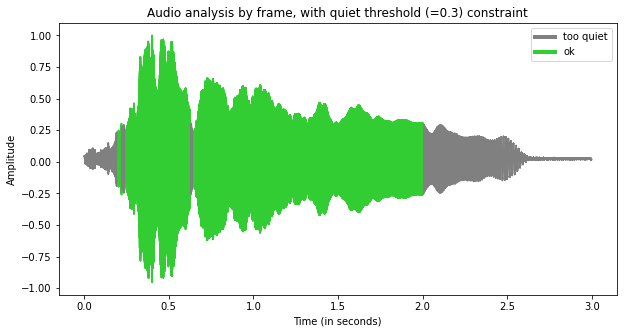

165 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [12]:
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices,
                                                  plot=True, quiet_threshold=0.3,
                                                  prominence=0.1)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


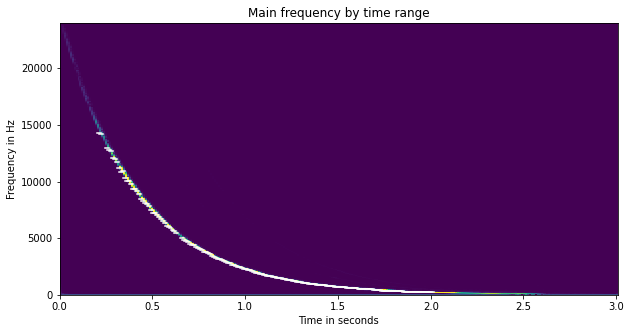

165 valid frames were analysed.
115 frames were discarded because too quiet.


In [13]:
stft_main_freqs(data, fs, freqs_by_time_range)

Finally, we ran the basic MUSIC algorithm on each of those frames with their main frequency each time.

Hereafter you can observe the Spatial Spectrums of every (not too quiet) frame superposed.

In [14]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None and len(freqs)>0:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

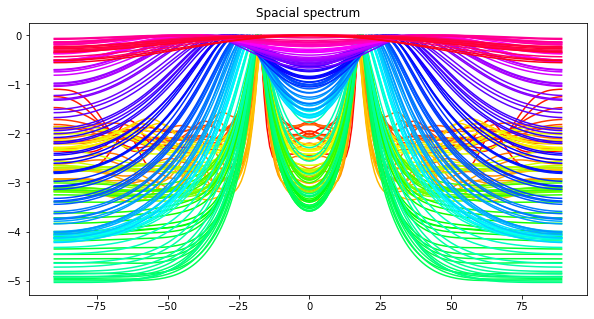

In [15]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

The final step of our algorithm was to retrieve the _n_ spectrums containing the _peakiest_ peaks overall and to take their mean (which is only possible because we know this is a single source case).

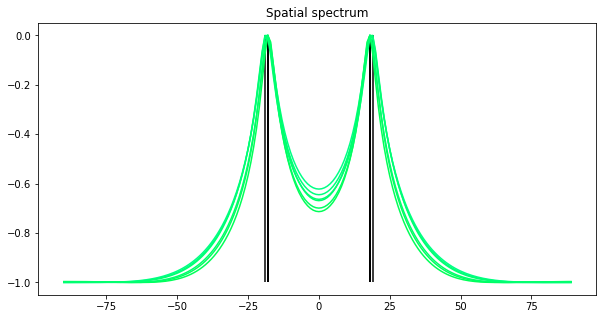

In [16]:
angles_found_array, mean_angle = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=6, prominence=0.5)

In [17]:
print(f"Actual direction of arrival: {directions_of_arrival[0]} degrees")
print(f"Directions found: {angles_found_array}")
print(f"Mean direction found: {mean_angle} degrees")

Actual direction of arrival: 20 degrees
Directions found: [18, 18, 18, 18, 18, 19]
Mean direction found: 18.166666666666668 degrees


In the following, we will always use the final technique, i.e the frame based one.

Let us now try the improved version of the Music for DOA algorithm.

In [18]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=2, M=len(side1_mic_indices),L=5)
        P_MUSIC_array.append(P_MUSIC)

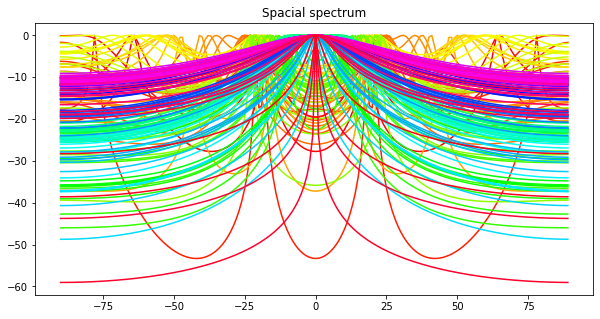

In [19]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

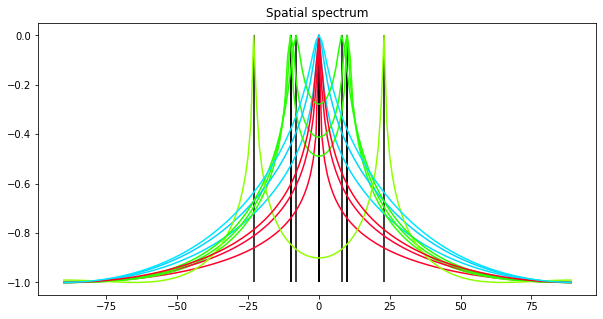

In [20]:
angles_found_array, mean_angle = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=10, prominence=0.8)

In [21]:
print(f"Actual direction of arrival: {directions_of_arrival[0]} degrees")
print(f"Directions found: {angles_found_array}")
print(f"Mean direction found: {mean_angle} degrees")

Actual direction of arrival: 20 degrees
Directions found: [0, 0, 10, 0, 10, 0, 23, 8, 0, 0]
Mean direction found: 5.1 degrees


Unfortunately, this version of the algorithm does not work well with our implementation.

### Two sources - correlated

#### Sweep

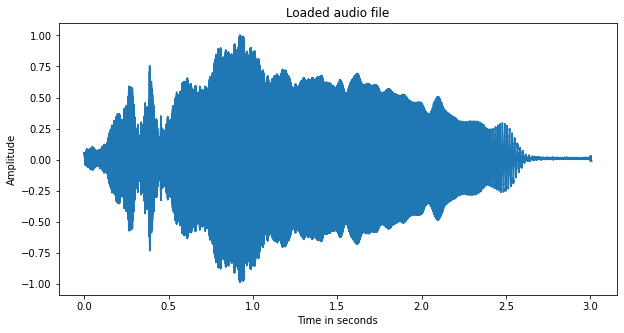

In [22]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("sweepco", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

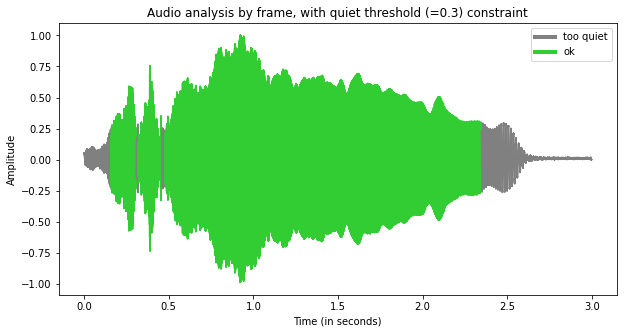

202 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [23]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


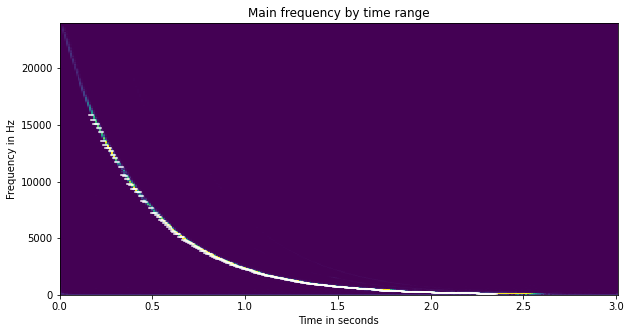

202 valid frames were analysed.
78 frames were discarded because too quiet.


In [24]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [25]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

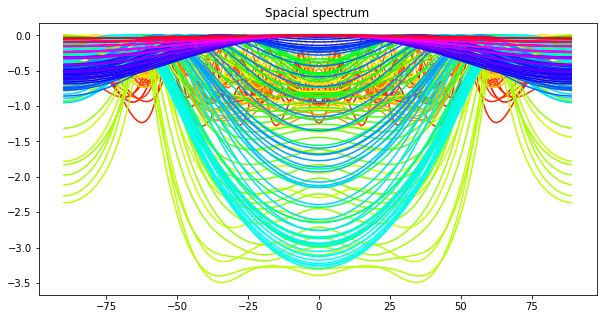

In [26]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

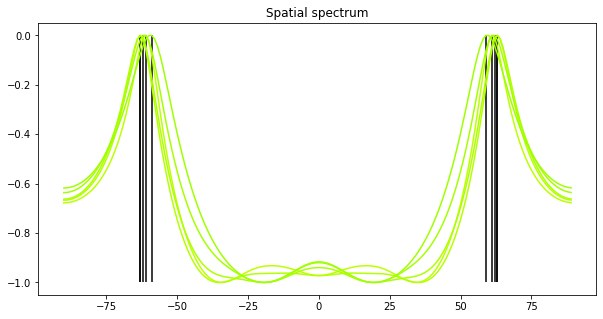

In [27]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [28]:
# Directions found using the pyroomacoustics implementation of MUSIC: 32, 66 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [61, 63, 63, 62, 59]


Since this is a correlated signal, it is expected that the basic version of MUSIC would not work well, and only find one of the two directions of arrival (which is the case as we can see that one frame gave as output 58 degrees, which is pretty close).

The improved version should work better on correlated signals.

In [29]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=2, M=len(side1_mic_indices),L=5,corr=True)
        P_MUSIC_array.append(P_MUSIC)

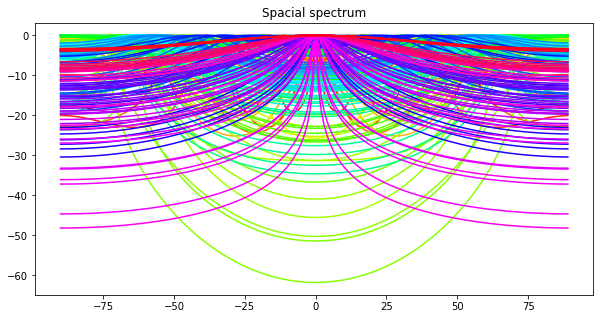

In [30]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

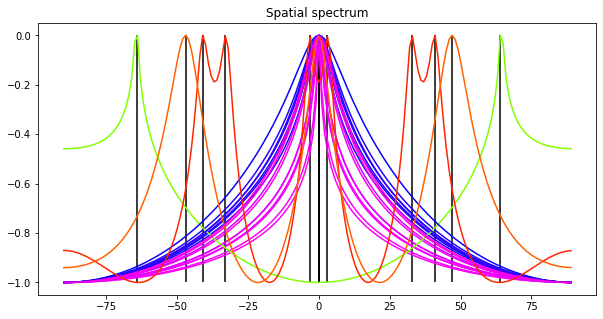

In [31]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=20, prominence=0.5)

In [32]:
# Directions found using the pyroomacoustics implementation of MUSIC: 32, 66 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 64, 0, 0, 0, 41, 47, 0]


Unfortunately, the improved version did not give convincing results...

#### Speech correlated

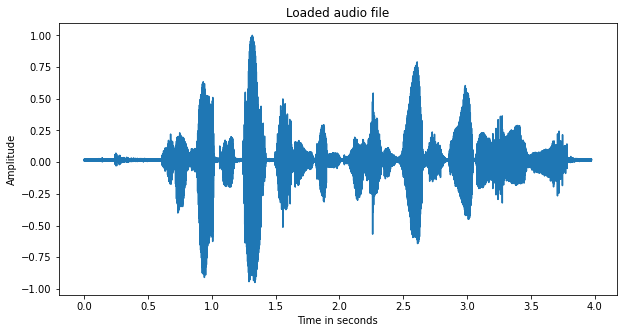

In [33]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("speechco", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

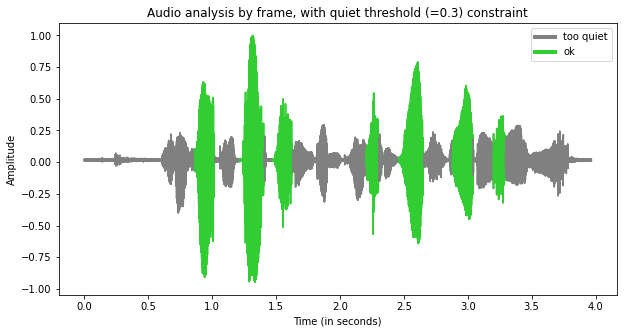

33 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [34]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


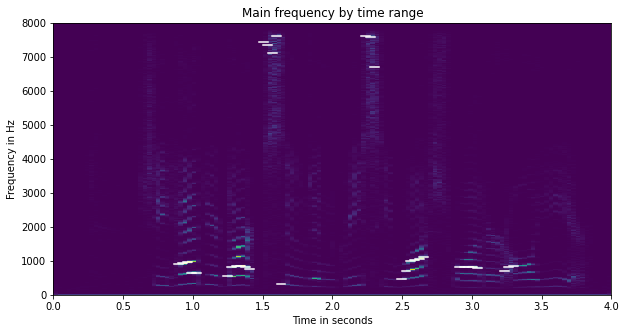

33 valid frames were analysed.
90 frames were discarded because too quiet.


In [35]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [36]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

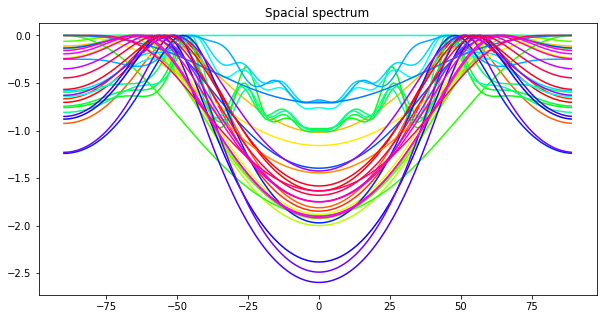

In [37]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

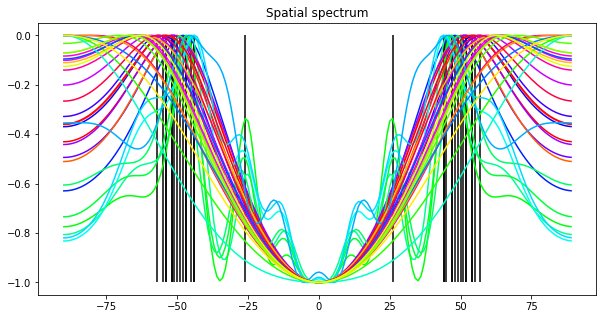

In [38]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=40, prominence=0.5)

In [39]:
# Directions found using the pyroomacoustics implementation of MUSIC: 42, 10 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [48, 51, 50, 55, 57, 45, 47, 47, 52, 54, 44, 52, 49, 44, 54]


In [40]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=3, M=len(side1_mic_indices), L=5, corr=True)
        P_MUSIC_array.append(P_MUSIC)

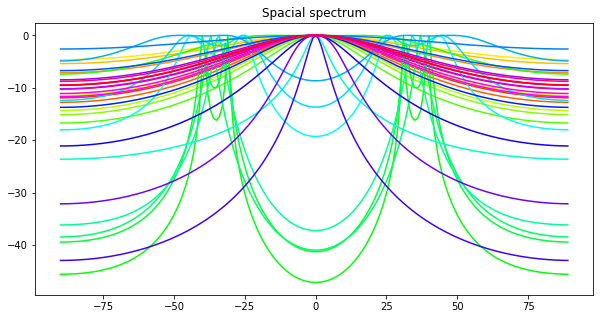

In [41]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

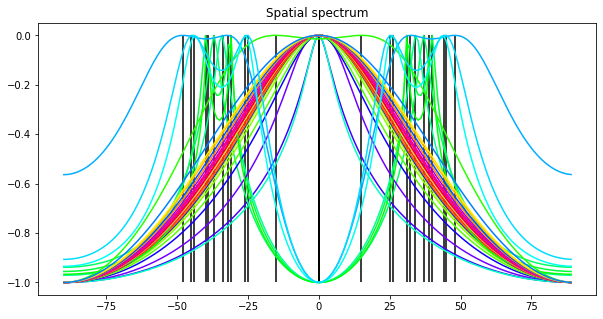

In [42]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=40, prominence=0.2)

In [43]:
# Directions found using the pyroomacoustics implementation of MUSIC: 42, 10 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [0, 40, 37, 34, 0, 0, 0, 0, 0, 0, 0, 0, 0, 39, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 15, 0, 0, 0, 48, 0, 44, 0, 45]


### Two sources - uncorrelated

#### Combination of 2 uncorrelated samples with known angles

In this part we tried to create a two-source-uncorrelated-signal by adding up two different signals, coming from different directions.

In [44]:
shortname1 = "s1_sp0_20"
shortname2 = "s3_sp0_70"
chosen_file_path1 = data_path / filenames[shortname1]
chosen_file_path2 = data_path / filenames[shortname2]
angles = [int(shortname1[-2:]), int(shortname2[-2:])]

fs1, data1 = wavfile.read(chosen_file_path1)
fs2, data2 = wavfile.read(chosen_file_path2)
if(len(data1) != len(data2)):
    size_pad = abs(len(data1) - len(data2))
    padding = np.zeros((size_pad, len(data1[0])))
    if(len(data1) > len(data2)):
        data2 = np.concatenate((data2, padding), axis=0)
    else:
        data1 = np.concatenate(data1, padding)
final_data = data1 + data2

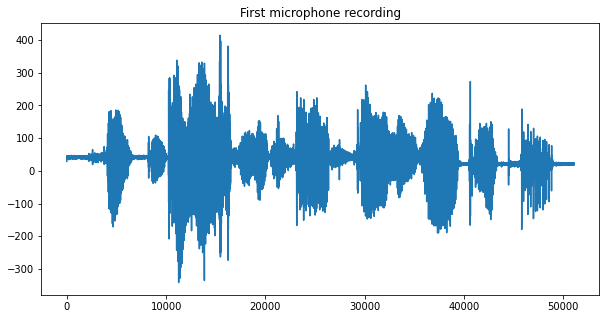

In [45]:
plt.plot(final_data[:, 0])
plt.title("First microphone recording")
plt.show()

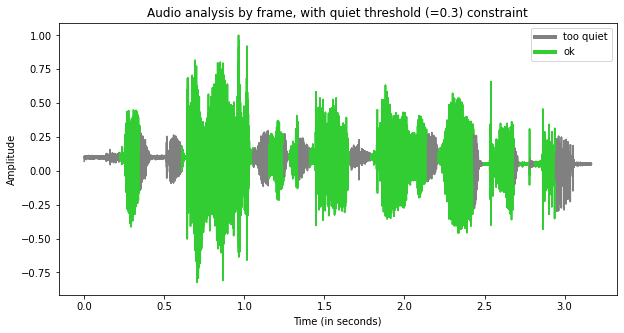

61 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [46]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(final_data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


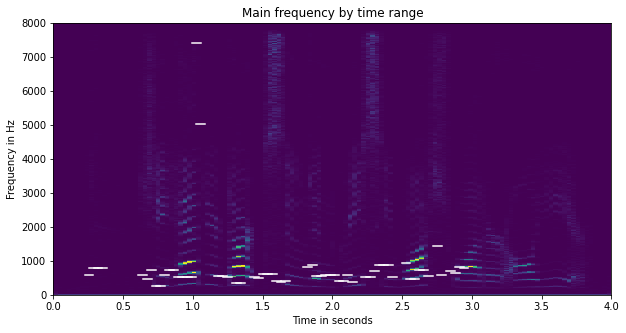

61 valid frames were analysed.
37 frames were discarded because too quiet.


In [47]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [48]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

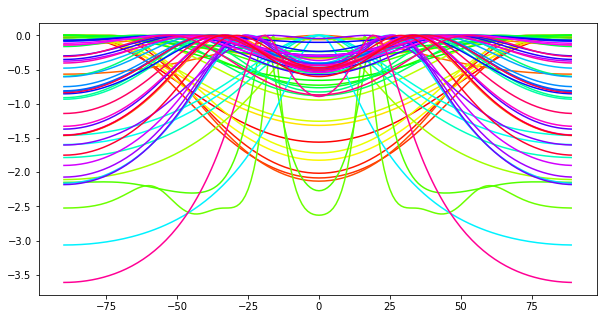

In [49]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

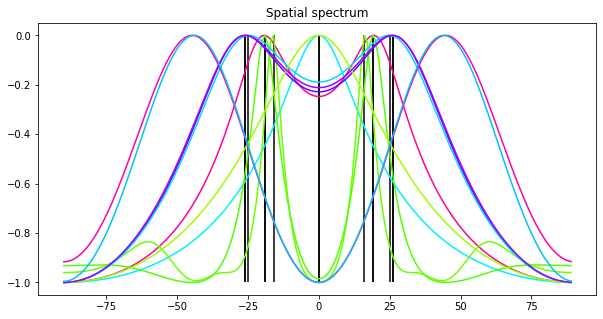

In [50]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=10, prominence=2)

In [51]:
# Directions to find (by design): 20, 70 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [19, 0, 16, 19, 26, 25, 0, 26]


Peaks are too wide and not prominent enough for a good approximation, and are giving only one angle here.
The improved Music Algorithm should solve this issue.

In [52]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=2, M=len(side1_mic_indices),L=5)
        P_MUSIC_array.append(P_MUSIC)

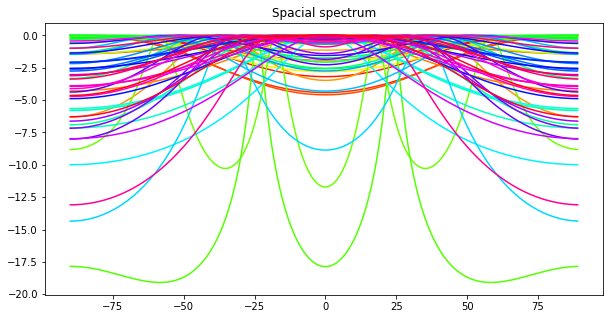

In [53]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

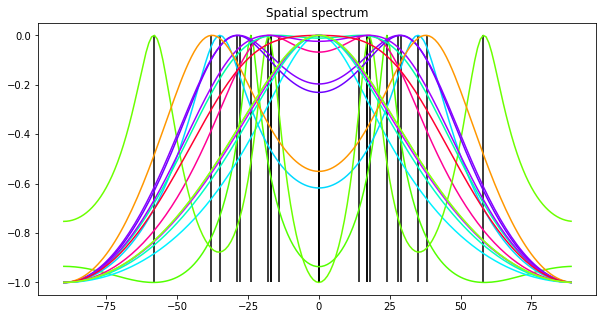

In [54]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=15, prominence=0.5)

In [55]:
# Directions to find (by design): 20, 70 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [24, 35, 17, 0, 58, 29, 0, 28, 0, 14, 17, 38, 0, 0, 0]


#### Sweep

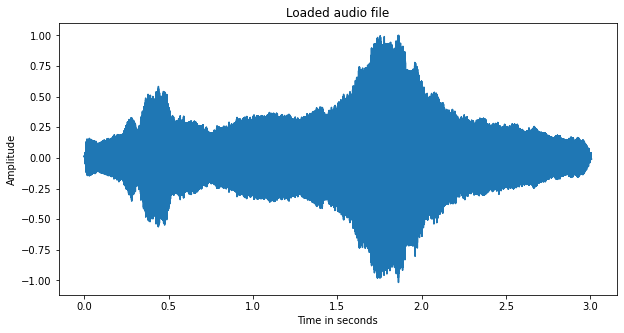

In [56]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("sweepun", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

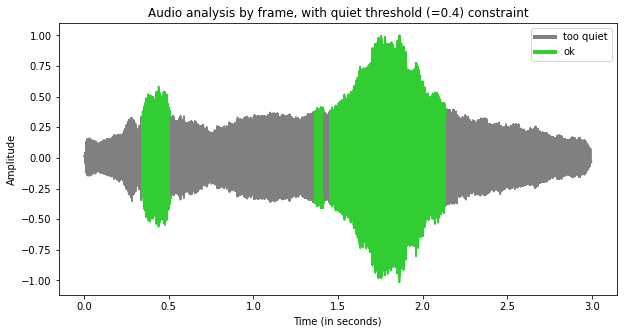

86 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [57]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.4)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


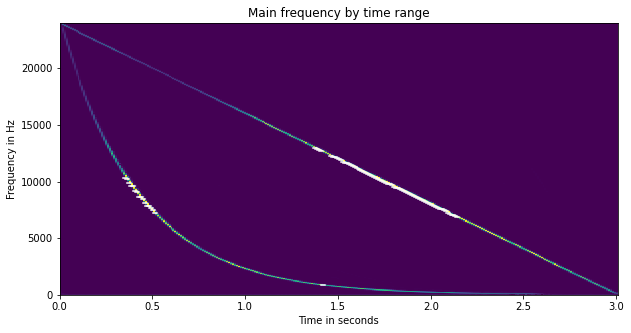

86 valid frames were analysed.
194 frames were discarded because too quiet.


In [58]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [59]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

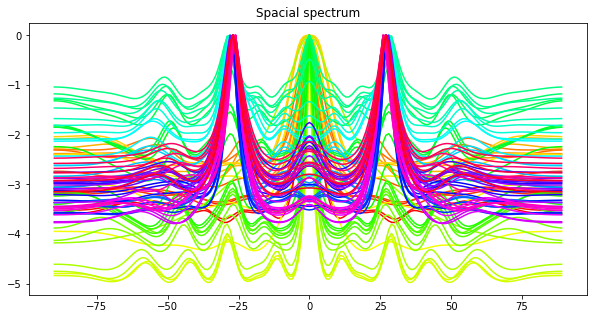

In [60]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

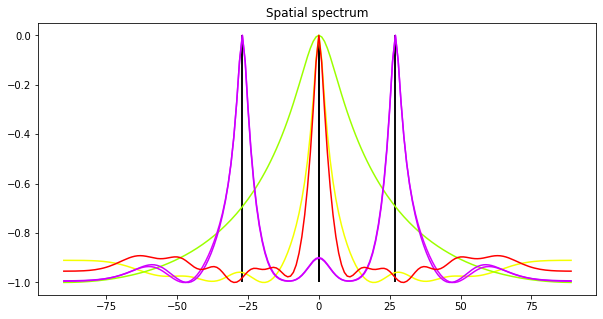

In [61]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [62]:
# Directions found using the pyroomacoustics implementation of MUSIC: 30, 60 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 27, 27, 0]


In [63]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=2, M=len(side1_mic_indices),L=5)
        P_MUSIC_array.append(P_MUSIC)

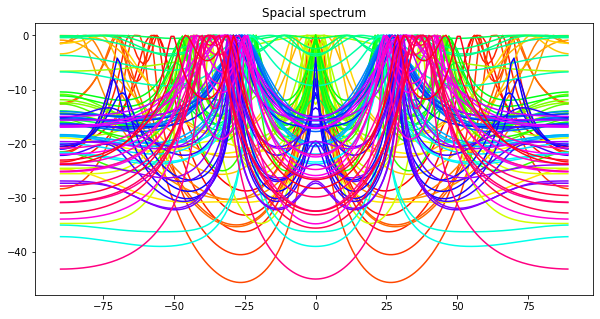

In [64]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

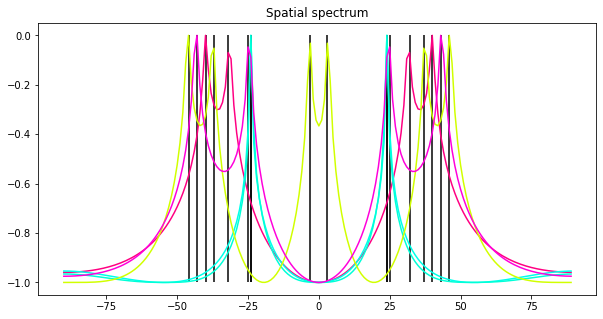

In [65]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [66]:
# Directions found using the pyroomacoustics implementation of MUSIC: 30, 60 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [40, 24, 24, 46, 43]


### Speech

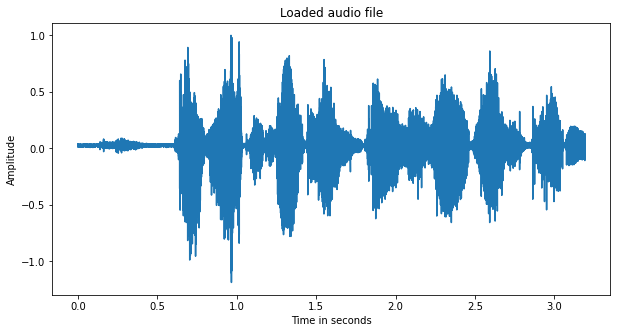

In [67]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("speechun", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

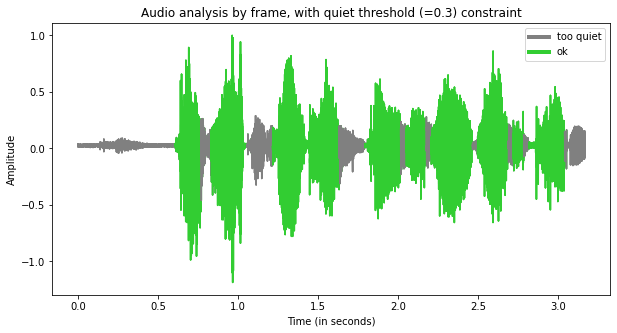

59 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [68]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data) / 10)


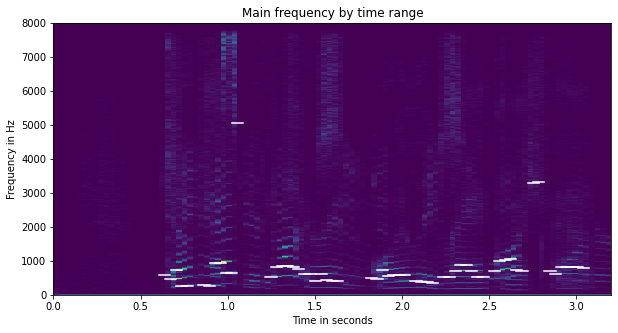

59 valid frames were analysed.
39 frames were discarded because too quiet.


In [69]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [70]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

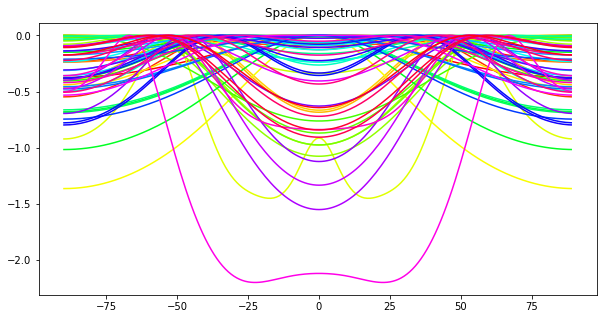

In [71]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

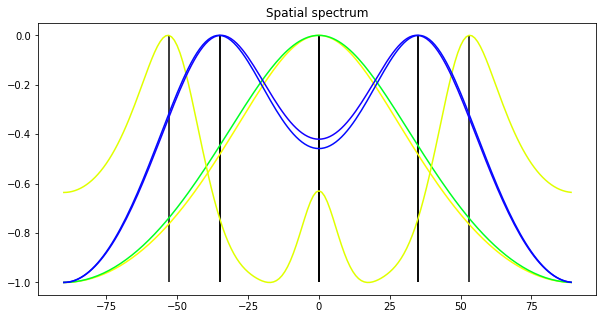

In [72]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [73]:
# Directions found using the pyroomacoustics implementation of MUSIC: 8, 60 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 53, 35, 35]


We observe that the basic Music for DOA algorithm is (as expected from the previous results) not very precise with correlated data.
We also obtain only one angle for the two sources, which is of course incorrect.

In [74]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = improved_musicDOA(X_array[i], f=freqs[0], d=d, D=2, M=len(side1_mic_indices),L=5)
        P_MUSIC_array.append(P_MUSIC)

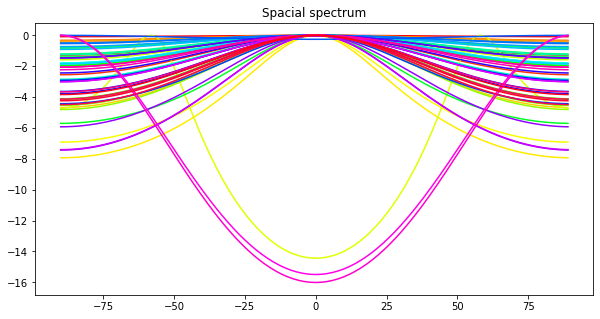

In [75]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

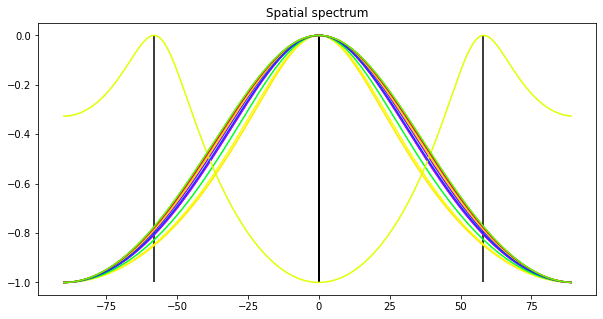

In [76]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=15, prominence=0.5)

In [77]:
# Directions found using the pyroomacoustics implementation of MUSIC: 8, 60 degrees
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 0, 0, 0, 0, 0, 58, 0, 0, 0, 0, 0, 0, 0]


#### Conclusion

As a conclusion, the basic MUSIC algorithm works pretty well on a single source exponential sweep and even better with a frame-based method. MUSIC seems to work better on sweeps since it is closer to a harmonic signal, and therefore fulfills the basic assumptions better than speech signals, which have a more complex frequency structure. However, the improved version needs refining.

Further works: 
- Use the 3D architecture of the pyramic array
- One could also try machine learning techniques on the array output by the frame-based method in order to remove outliers and group DOAs by clusters.